In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 75.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 56.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 105.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [ ]:
from ultralytics import YOLO
import cv2
import os
import random
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow
from PIL import Image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Dataset**

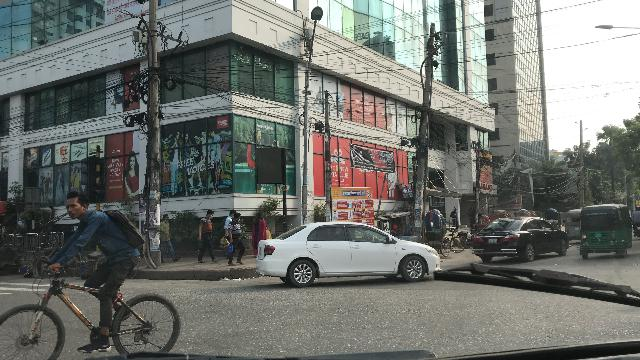

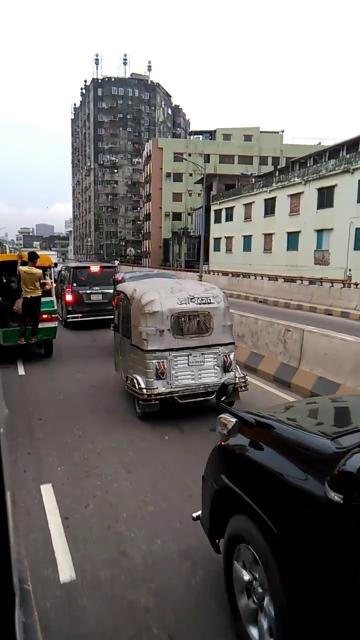

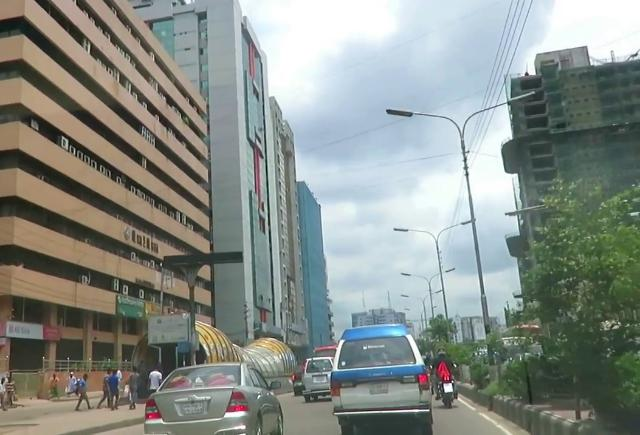

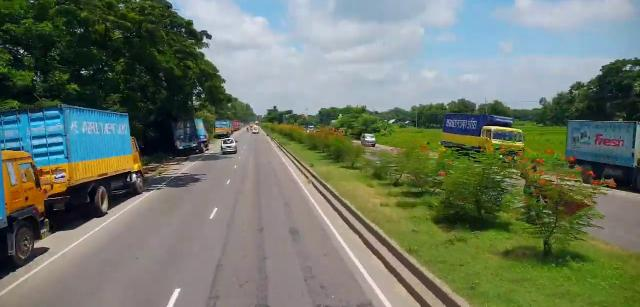

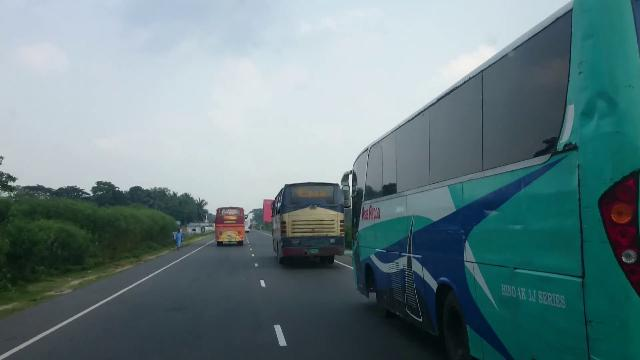

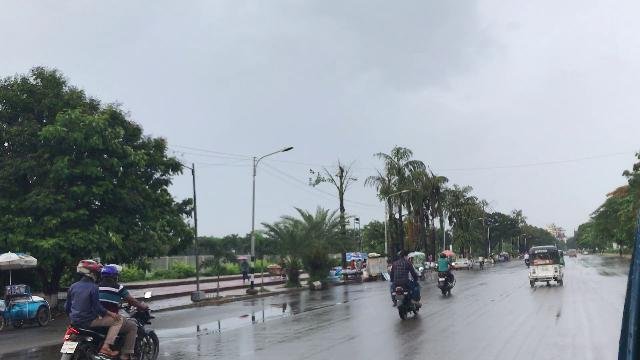

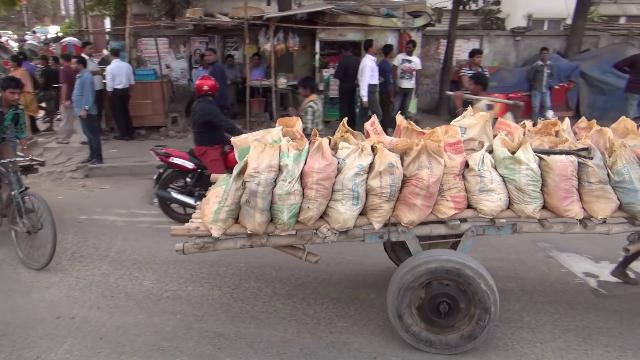

In [ ]:
images_dir = "/content/drive/MyDrive/Images_data/train/images"

for file in os.listdir(images_dir)[:7]:
  img = cv2.imread(os.path.join(images_dir, file))
  cv2_imshow(img)

In [ ]:
# Unique objects in images
with open('/content/drive/MyDrive/Images_data/data_1.yaml', 'r') as f:
  data = f.read()
  print(data)

train: ../train/images
val: ../valid/images

nc: 21
names: ['ambulance', 'army vehicle', 'auto rickshaw', 'bicycle', 'bus', 'car', 'garbagevan', 'human hauler', 'minibus', 'minivan', 'motorbike', 'pickup', 'policecar', 'rickshaw', 'scooter', 'suv', 'taxi', 'three wheelers -CNG-', 'truck', 'van', 'wheelbarrow']


In [ ]:
# Image objects detection
image_train_label = "/content/drive/MyDrive/Images_data/train/labels"

def load_labels(image_files, image_train_labels):
  label_file = os.path.splitext(image_files)[0] + ".txt"
  label_path = os.path.join(image_train_label, label_file)

  with open(label_path, "r") as f:
    labels = f.read().strip().split("\n")

  return labels

def image_object_detection(ax, image, labels):
  for label in labels:
    if len(label.split()) != 5:
      continue
    class_id, x_center, y_center, width, height = map(float, label.split())
    x_min = int((x_center - width / 2) * image.shape[1])
    y_min = int((y_center - height / 2) * image.shape[0])
    x_max = int((x_center + width / 2) * image.shape[1])
    y_max = int((y_center + height / 2) * image.shape[0])
    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 3)

  ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  ax.axis("off")

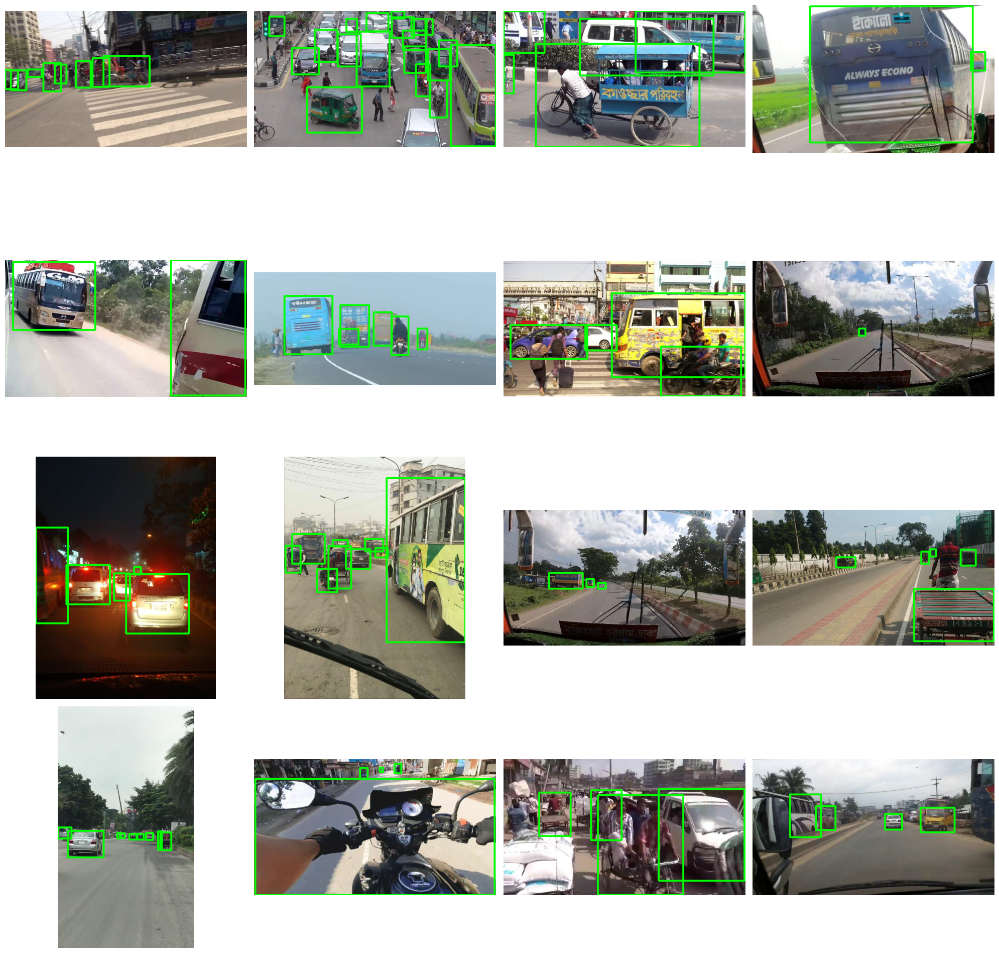

In [ ]:
# Plot the object detection
images_dir = "/content/drive/MyDrive/Images_data/train/images"
image_train_label = "/content/drive/MyDrive/Images_data/train/labels"

image_all_file = os.listdir(images_dir)
random_image = random.sample(image_all_file, 16)
fig, axs = plt.subplots(4, 4, figsize=(20, 20))

for i, image_file in enumerate(random_image):
  row, col = divmod(i, 4)
  image_path = os.path.join(images_dir, image_file)
  image = cv2.imread(image_path)
  labels = load_labels(image_file, image_train_label)
  image_object_detection(axs[row, col], image, labels)

plt.tight_layout()
plt.show()

**YOLO v8 model implementation**

In [ ]:
# Model training for 50 epochs
!yolo task= detect mode= train model= yolov8n.pt data= /content/drive/MyDrive/Images_data/data_1.yaml epochs=50 batch=16 imgsz=640

100% 6.25M/6.25M [00:00<00:00, 77.7MB/s]
Ultralytics 8.3.152 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/Images_data/data_1.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patie

In [ ]:
train_out_dir = "/content/runs/detect/train"
os.listdir(train_out_dir)

['val_batch2_pred.jpg',
 'train_batch6760.jpg',
 'val_batch2_labels.jpg',
 'val_batch0_pred.jpg',
 'args.yaml',
 'val_batch1_labels.jpg',
 'P_curve.png',
 'train_batch2.jpg',
 'confusion_matrix.png',
 'PR_curve.png',
 'results.csv',
 'train_batch6761.jpg',
 'train_batch6762.jpg',
 'F1_curve.png',
 'val_batch0_labels.jpg',
 'weights',
 'val_batch1_pred.jpg',
 'results.png',
 'labels.jpg',
 'R_curve.png',
 'train_batch1.jpg',
 'confusion_matrix_normalized.png',
 'train_batch0.jpg',
 'labels_correlogram.jpg']

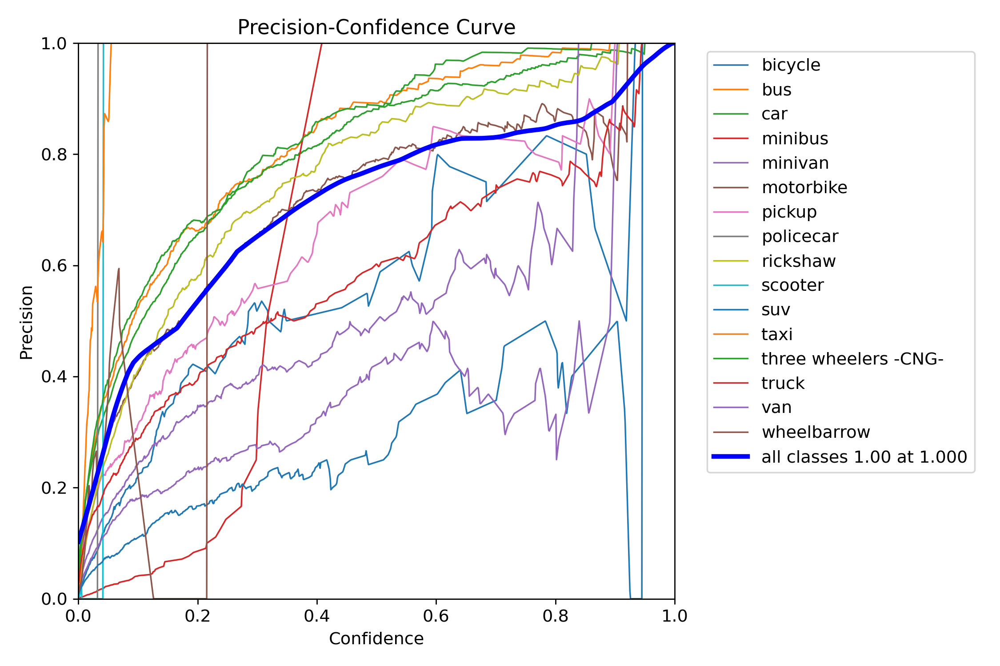

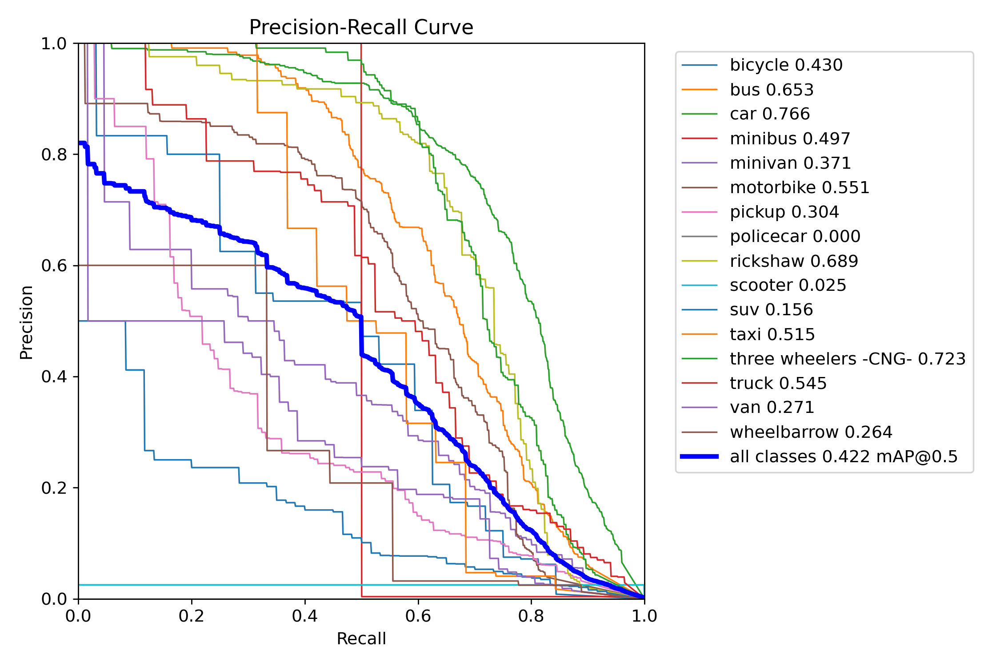

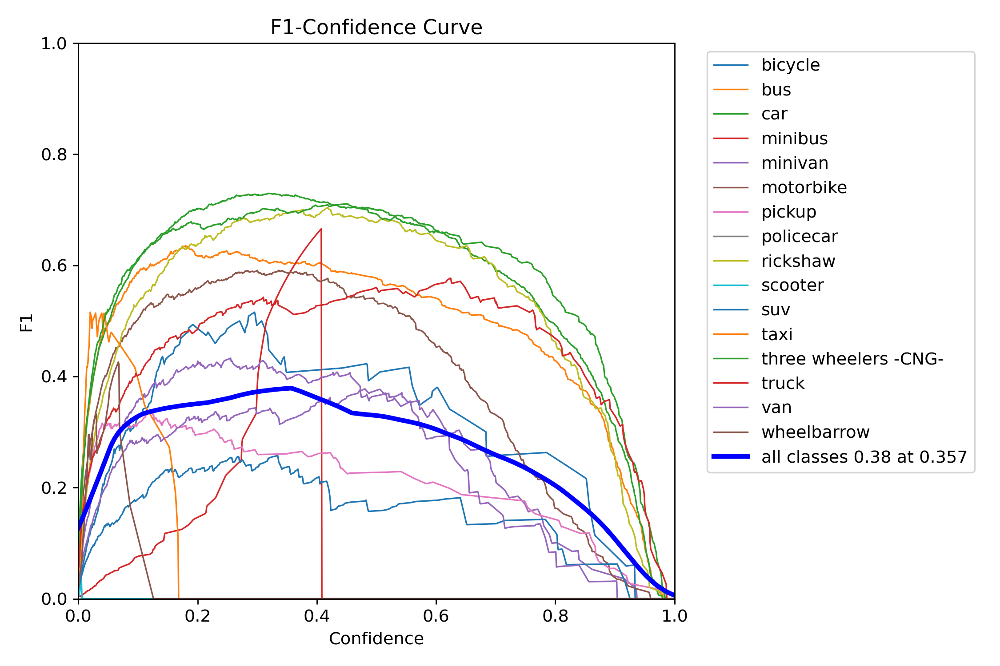

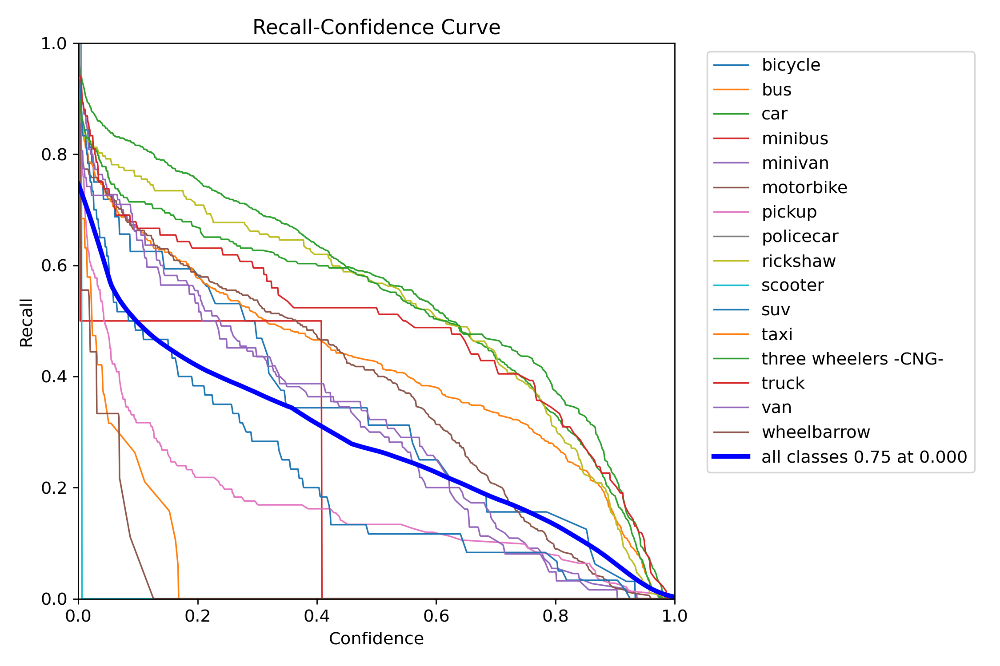

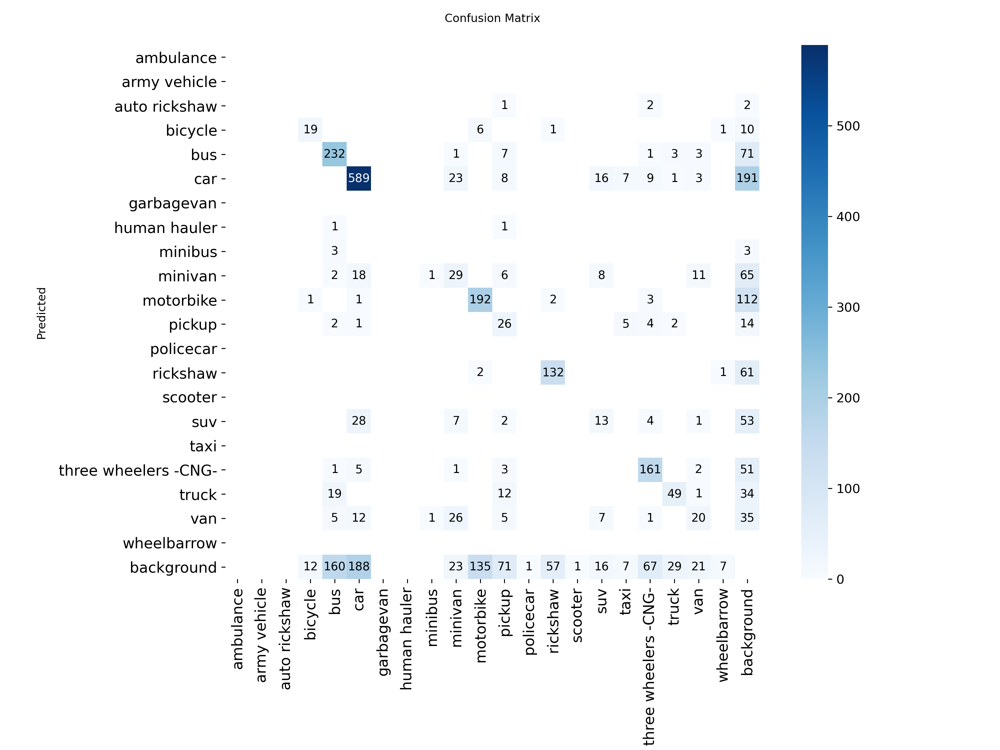

In [ ]:
# P_curve, confusion_matrix, PR_curve, F1_curve, R_curve
image_files = ['P_curve.png', 'PR_curve.png', 'F1_curve.png', 'R_curve.png', 'confusion_matrix.png']

for file in image_files:
  img = cv2.imread(os.path.join(train_out_dir, file))
  cv2_imshow(img)

In [ ]:
# model performance
df = pd.read_csv("/content/runs/detect/train/results.csv")
df.head()

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,76.1292,1.51333,3.36830,1.16943,0.59126,0.15302,0.12920,0.07503,1.44663,2.15530,1.14460,0.000133,0.000133,0.000133
1,2,140.3750,1.46998,2.22099,1.17440,0.49973,0.21260,0.16190,0.09361,1.51530,1.90554,1.21223,0.000261,0.000261,0.000261
2,3,199.7770,1.42671,1.98527,1.16189,0.55627,0.22057,0.21435,0.12764,1.44394,1.77381,1.16622,0.000383,0.000383,0.000383
3,4,262.0710,1.41119,1.86855,1.14872,0.54125,0.23008,0.21839,0.13067,1.41216,1.76153,1.16214,0.000376,0.000376,0.000376
4,5,327.9010,1.39137,1.77429,1.13433,0.59238,0.26610,0.25381,0.15518,1.30237,1.59301,1.11296,0.000368,0.000368,0.000368


In [ ]:
df.columns

Index(['epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')

<Axes: xlabel='epoch', ylabel='val/dfl_loss'>

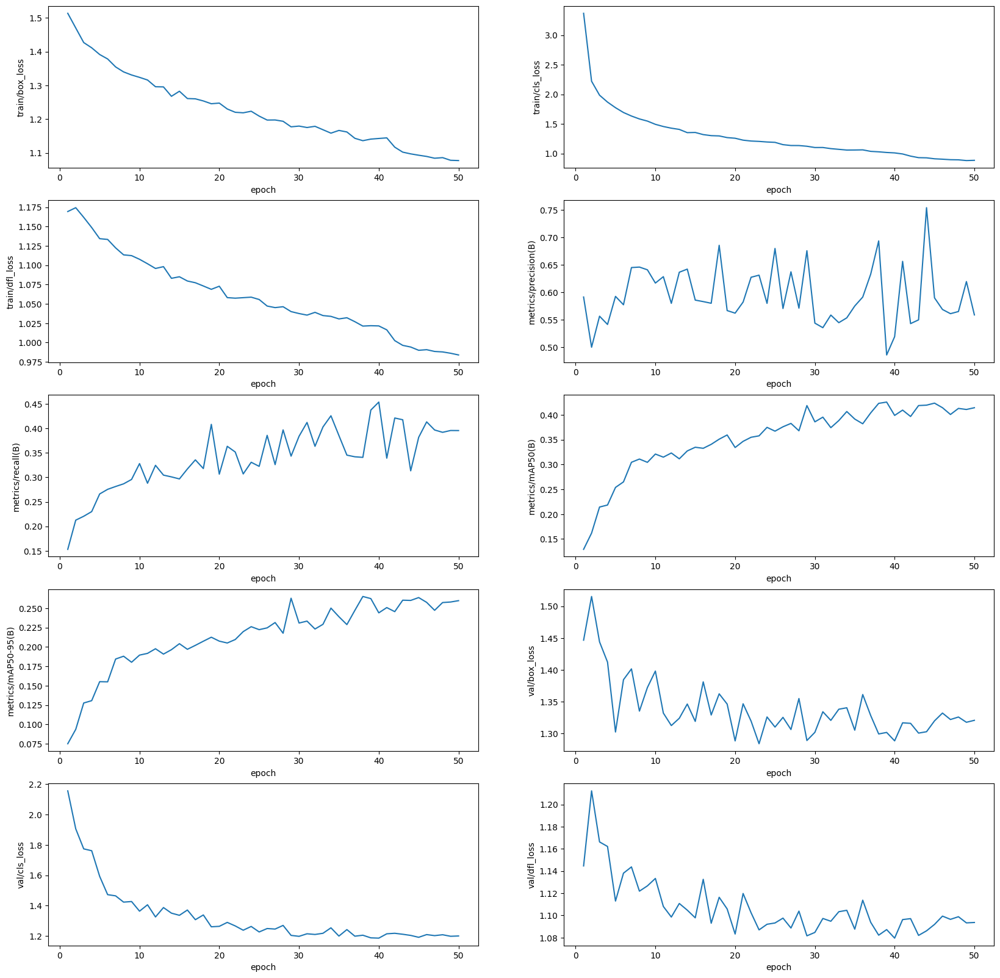

In [ ]:
# Training metrics and loss
df.columns = df.columns.str.strip()
fix, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))

# Plotting the Columns
sns.lineplot(x='epoch', y='train/box_loss', data=df, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=df, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=df, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=df, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=df, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=df, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=df, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=df, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=df, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=df, ax=axs[4,1])

# Titles and labels
axs[0,0].set(title='Train box loss')
axs[0,1].set(title='Train class loss')
axs[1,0].set(title='Train DFL loss')
axs[1,1].set(title='Metrics precision(B)')
axs[2,0].set(title='Metrics recall(B)')
axs[2,1].set(title='Metrics mAP50(B)')
axs[3,0].set(title='Metrics mAP50-95(B)')
axs[3,1].set(title='Validation box loss')
axs[4,0].set(title='Validation classloss')
axs[4,1].set(title='Validation DFL loss')

plt.suptitle("Training metrics and loss")
plt.tight_layout()
plt.show()

In [ ]:
# Test Evaluation
!yolo task = detect mode = predict model = /content/runs/detect/train/weights/best.pt source = /content/drive/MyDrive/Images_data/valid/images conf=0.25

Ultralytics 8.3.152 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,009,743 parameters, 0 gradients, 8.1 GFLOPs

image 1/300 /content/drive/MyDrive/Images_data/valid/images/Pias--139-_jpg.rf.3480cbf4cd5e0ba990e49896b2a3d9aa.jpg: 384x640 3 cars, 2 suvs, 47.9ms
image 2/300 /content/drive/MyDrive/Images_data/valid/images/Pias--14-_jpg.rf.bc90f7011d8a8519dd9c8eeb3f4a5bce.jpg: 384x640 1 bicycle, 4 cars, 1 minivan, 2 motorbikes, 1 van, 6.9ms
image 3/300 /content/drive/MyDrive/Images_data/valid/images/Pias--140-_jpg.rf.1fa359c696f211a5fe03f52d0d7c004a.jpg: 384x640 1 bus, 2 cars, 1 minivan, 2 motorbikes, 1 pickup, 1 three wheelers -CNG-, 1 van, 6.3ms
image 4/300 /content/drive/MyDrive/Images_data/valid/images/Pias--141-_jpg.rf.faba2aa0d33f0cf10d64d508652c2c3d.jpg: 384x640 5 cars, 2 motorbikes, 1 three wheelers -CNG-, 18.6ms
image 5/300 /content/drive/MyDrive/Images_data/valid/images/Pias--142-_jpg.rf.1f52a77da4d54b26bd0ef1e43c839f03.jpg: 384x6

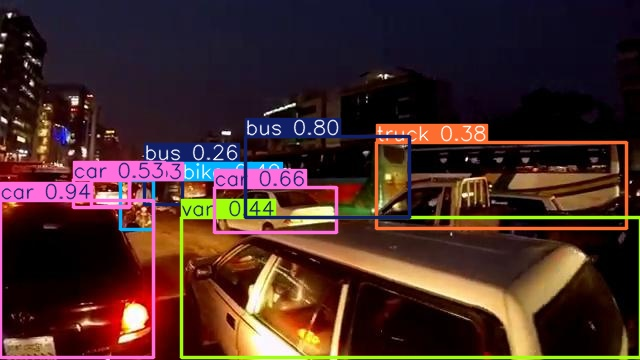

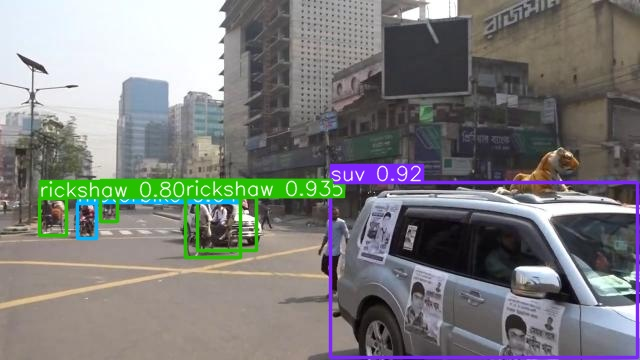

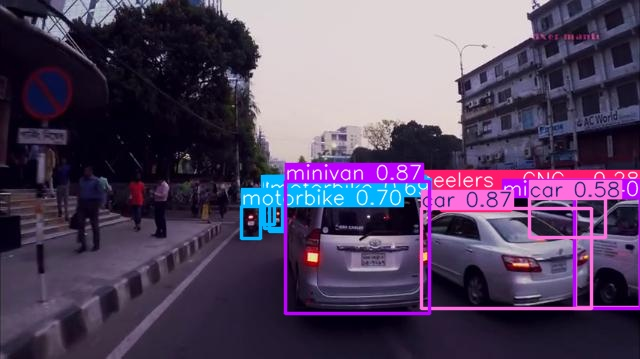

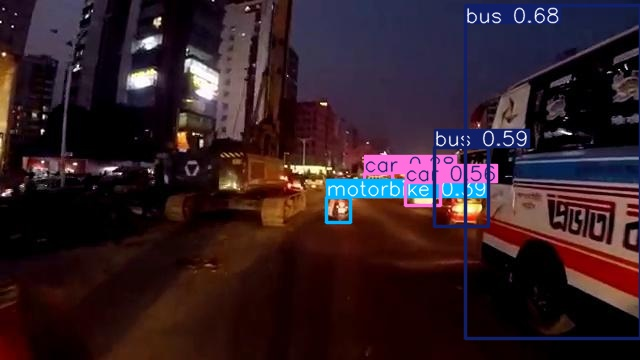

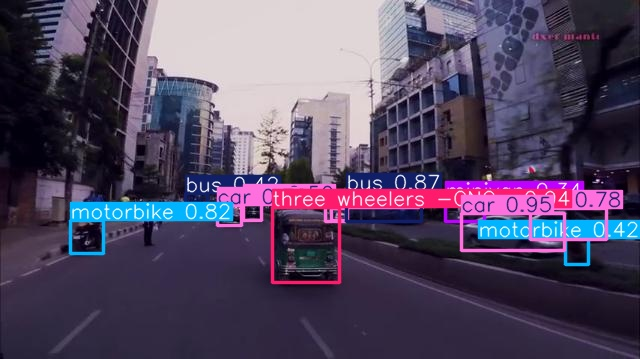

...

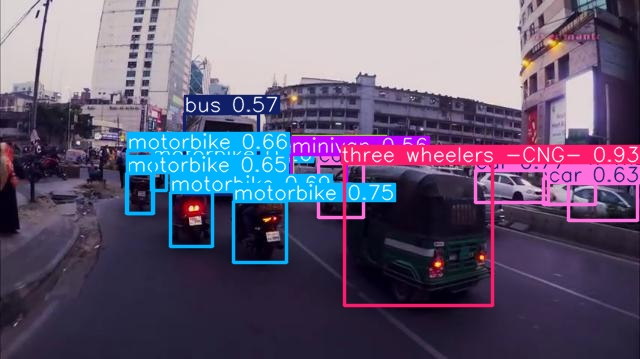

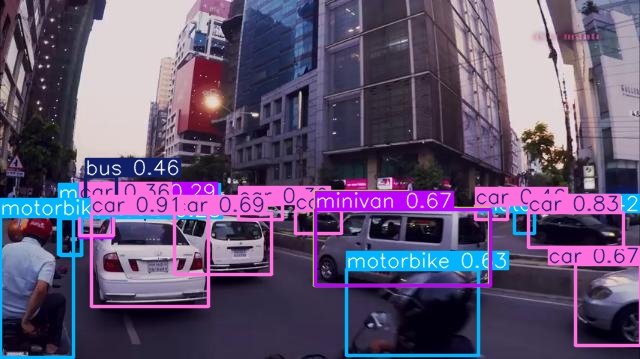

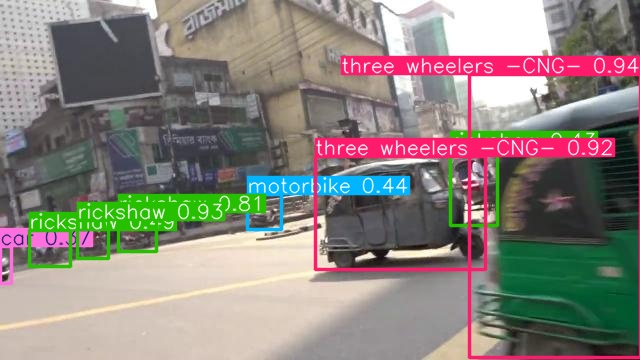

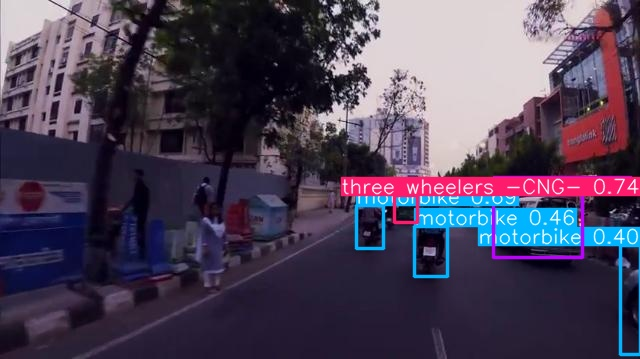

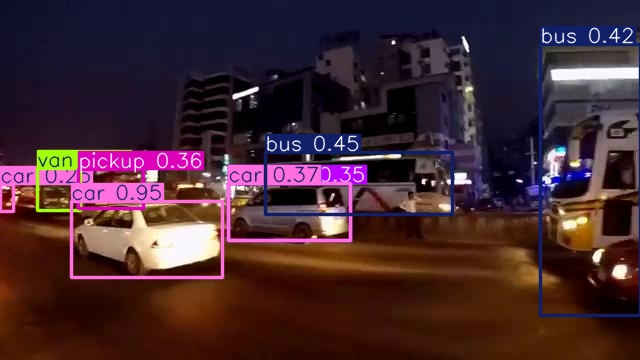

In [ ]:
# Object detection
test_dir = "/content/runs/detect/predict"
test_list = os.listdir(test_dir)
random.shuffle(test_list)

for file in test_list[:30]:
  img = cv2.imread(os.path.join(test_dir, file))
  cv2_imshow(img)